# 2. Exploratory Data Analysis (EDA)

## Data Cleaning & Visualization

**Sari Farah**

**BrainStation, Data Science**

**Previous Notebook: 1. Data Loading**

**Next Notebook: 3. Modelling**

In the previous notebook, we completed Data loading.

In this notebook, we will be performing some feature engineering, exploratory data analysis, and some data visualization.

### Data cleaning and EDA 

First, lets import our packages and read in the cleaned data.

In [2]:
#importing the libraries I need 

import numpy as np 
import pandas as pd 

import seaborn as sns
from matplotlib.patches import Arc
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.stats import norm
import math
import plotly.express as px

In [3]:
#reading in my data 
df = pd.read_csv('/Users/sarifarah/Desktop/sari_farah_Capstone_final/shots_df_EDA.csv')

# DATA CLEANING 

In [4]:
#visually inspecting the data
df.head()

,id,minute,result,X,Y,player,h_a,player_id,situation,season,shotType,match_id,h_team,a_team,h_goals,a_goals,date,player_assisted,lastAction
0,200247,27,BlockedShot,0.794,0.421,Juan Mata,h,554,DirectFreekick,2015,LeftFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Standard
1,200248,27,BlockedShot,0.860,0.627,Memphis Depay,h,555,SetPiece,2015,RightFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Ashley Young,Pass
2,200249,35,BlockedShot,0.843,0.333,Juan Mata,h,554,OpenPlay,2015,LeftFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Wayne Rooney,Pass
3,200250,35,MissedShots,0.848,0.533,Juan Mata,h,554,OpenPlay,2015,LeftFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Tackle
4,200251,40,BlockedShot,0.812,0.707,Memphis Depay,h,555,OpenPlay,2015,RightFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Michael Carrick,BallRecovery


In [5]:
# the shape of my data
df.shape

(227614, 19)

In [6]:
#summarize dimensions and missing values:
print(f'Rows: {df.shape[0]}')
print(f'Columns: {df.shape[1]}')
print(f'Missing: {df.isna().sum().sum()}')

Rows: 227614
Columns: 19
Missing: 60453


In [7]:
#Inspecting the different data types my data contains.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 19 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  object 
 3   X                227614 non-null  float64
 4   Y                227614 non-null  float64
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  object 
 7   player_id        227614 non-null  int64  
 8   situation        227614 non-null  object 
 9   season           227614 non-null  int64  
 10  shotType         227614 non-null  object 
 11  match_id         227614 non-null  int64  
 12  h_team           227614 non-null  object 
 13  a_team           227614 non-null  object 
 14  h_goals          227614 non-null  int64  
 15  a_goals          227614 non-null  int64  
 16  date             227614 non-null  obje

We can see that all our null values are in the `player_assisted` column.

Things I need to address: 

- `Result`: Needs to binary. 
 - 1 = goal.
 - 0 = no goal.
- `X` and `Y`: they are currently on a relative scale between 0 and 1. We need to transform them my multiplying by the width and length of the pitch. 
 - (`X` = length of pitch)
 - (`Y` = width of pitch). 
 - Standard football fields are 105 meters in legth and 68 meters in width. 
 - So we must multiply the X values you by 105 and the Y values by 68.  
 - Feauture engineer Distance and Angle columns
- `h_a` : Home and Away will be switched to binary aswell. 
 - Home(h) = 1 
 - Away(a) = 0
- `Date`: `Date` needs to be in the datetime format.
 - Then will be divided into different columns
- `player_assisted` column:
 - Deal with the `player_assisted` null values. 
 - Then binarize this column to was this shot assisted or not. 
- Binarizing the `shotType` column
 - Any shot with left or right foot = 1 
 - Any shot with another body part = 0 
- Binarizing `situation` column:
 - openPlay = 1 
 - setpiece = 0
- Binarizing the `last_action` column
 - a cross or pass = 1 
 - anything else = 0 

### Binarizing the `result` column: 


In [8]:
#checking each class within the result column
df['result'].value_counts()

MissedShots    89115
BlockedShot    56209
SavedShot      53180
Goal           24091
ShotOnPost      4313
OwnGoal          706
Name: result, dtype: int64

In [9]:
df['result'].value_counts(normalize=True)

MissedShots    0.391518
BlockedShot    0.246949
SavedShot      0.233641
Goal           0.105841
ShotOnPost     0.018949
OwnGoal        0.003102
Name: result, dtype: float64

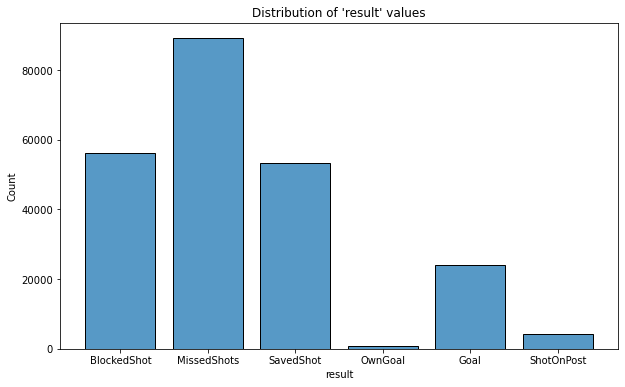

In [10]:
plt.figure(figsize=(10,6))
sns.histplot(df['result'], discrete=True, shrink=0.8)
plt.title("Distribution of 'result' values")
plt.show()

As we can see from the above graph and tables. Most shots are missed shots followed by blocked and saved shots. Essentially these are all shots that have not resulted in a goal. We can binarize this column to either a goal or no goal. Something else that is important to note is that owngoals are not shots that are taken purposefully, becasue no player in their right mind would want to score on his own net, so this will also be grouped with no goal. Both ways, this does not make a big difference becasue it is only 0.3% of the all our observations. 

In [11]:
#binarize result column 
df["result"] = np.where(df["result"] == "Goal", 1, 0)

In [12]:
#sanity check 
df["result"].unique()

array([0, 1])

As we can see, the `result` column is now a binary column.

In [13]:
#absolute number of the differences in goals and non-goals 
df["result"].value_counts()

0    203523
1     24091
Name: result, dtype: int64

In [14]:
#relative number of goals vs non-goals 
df["result"].value_counts(normalize=True)

0    0.894159
1    0.105841
Name: result, dtype: float64

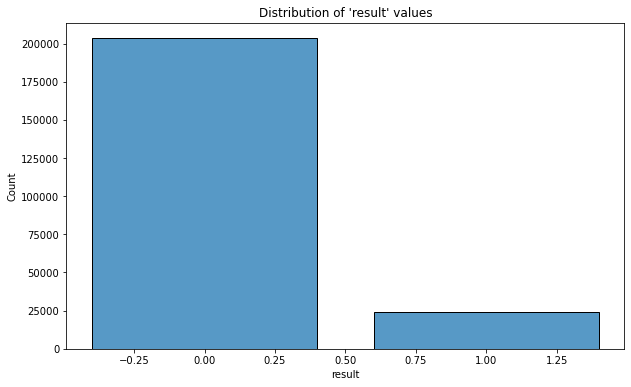

In [15]:
plt.figure(figsize=(10,6))
sns.histplot(df['result'], discrete=True, shrink=0.8)
plt.title("Distribution of 'result' values")
plt.show()

There is a large class imbalance between goals and no goals. There are 10% goals and the rest of the shots did not result in a goal. 

### Transforming with the `X` & `Y` axis: 

In [16]:
#transforming my coordinates from relative distance to real distance in metres.
#Football piuches may be different sizes but the average size in 105 metres by 68 metres.
df['X'] = df['X']*105
df['Y'] = df['Y']*68

In [17]:
#Simplifying to jsut 3 decimal places 
df['X'] = round(df['X'], 3)
df['Y'] = round(df['Y'], 3)

In [18]:
#Changing the data type from float to Int 
df['X']= df['X'].astype(int)
df['Y']= df['Y'].astype(int)

- X is the length (horizontal pitch)
- Y is the width (horizontal pitch)

In [19]:
#sanity check
df.head()

,id,minute,result,X,Y,player,h_a,player_id,situation,season,shotType,match_id,h_team,a_team,h_goals,a_goals,date,player_assisted,lastAction
0,200247,27,0,83,28,Juan Mata,h,554,DirectFreekick,2015,LeftFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Standard
1,200248,27,0,90,42,Memphis Depay,h,555,SetPiece,2015,RightFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Ashley Young,Pass
2,200249,35,0,88,22,Juan Mata,h,554,OpenPlay,2015,LeftFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Wayne Rooney,Pass
3,200250,35,0,89,36,Juan Mata,h,554,OpenPlay,2015,LeftFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Tackle
4,200251,40,0,85,48,Memphis Depay,h,555,OpenPlay,2015,RightFoot,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Michael Carrick,BallRecovery


As we can see, the `X` and `Y` axes are longer between 0 and 1. Also, the `result` column is binary.

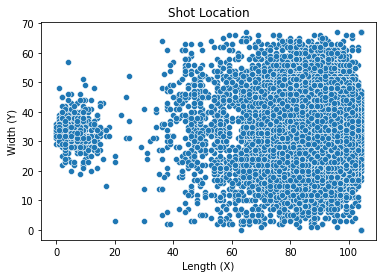

In [20]:
# A simple scatter plot 
plt.figure()
sns.scatterplot(data=df, x='X', y='Y')
plt.xlabel('Length (X)')
plt.ylabel('Width (Y)')
plt.title('Shot Location')

plt.show()

In [21]:
#An interactive plot 
fig = px.scatter(df, 
                 x='X', 
                 y='Y',
                 title='Shot location: X vs Y')
fig.show()

As we can see from the plot above, there is two main clusters. 
1. A small cluster (on the left side of the plot) with shots taken from a very far area around an average of 95 meters out.
2. A large cluster (on the right side of the plot) with shots taken from a closer area around an average of 20 meters out. 

I am interested to see if any goals were scored from very far out.

In [22]:
#testing for for a condition that will return a result if there was a goal from 70 meters out.
condition = (df["X"] < 40) & (df["result"] == 1)

df[condition]

,id,minute,result,X,Y,player,h_a,player_id,situation,season,shotType,match_id,h_team,a_team,h_goals,a_goals,date,player_assisted,lastAction


In [23]:
condition = (df["X"] < 52) & (df["result"] == 1)

df[condition]

,id,minute,result,X,Y,player,h_a,player_id,situation,season,shotType,match_id,h_team,a_team,h_goals,a_goals,date,player_assisted,lastAction
94698,161176,65,1,47,40,Wayne Rooney,h,629,OpenPlay,2017,RightFoot,7256,Everton,West Ham,4,0,2017-11-29 20:00:00,NaN,None


As we can see there was only one goal scored around 50 meters out. 


Here is a video: 
https://www.youtube.com/watch?v=mvsnAhzQ0Wk

In [32]:
#Color coded goal or no goal from shot location
fig = px.scatter(
    df, 
    x='X', 
    y='Y',
    title='Shot location: Goal vs No-Goal', 
    color = 'result',
    width=800,
    height=500,
)

fig.show()

Above is a color coded scatter plot of the field. It plots all the shots and color codes depending on the result. If the shot resulted in a goal it is colored as yellow, otherwise it is colored as blue. 

Some observations: 
- Not many yellow points (not many goals) 
- Not many shots behind 40 meters (X). Even though there is a bit of a cluster at around 15 meters.
- The closer we get to 105 meters (X), the more yellow we see.
- A cluster of yellow (goals) appears at aroung 100 meter mark. 
 - That means most goals scored tend to be scored nearer to the goal. 
 
It appears that the distance and angle at which the shot is taken play a significant role in whether the shot resulted in a goal. Let's explore this further. 


In [25]:
fig = px.histogram(
    df, 
    x='X',
    nbins=105,
    title="Shots from distance (length)",
    width=800,
    height=500
)
fig.show()

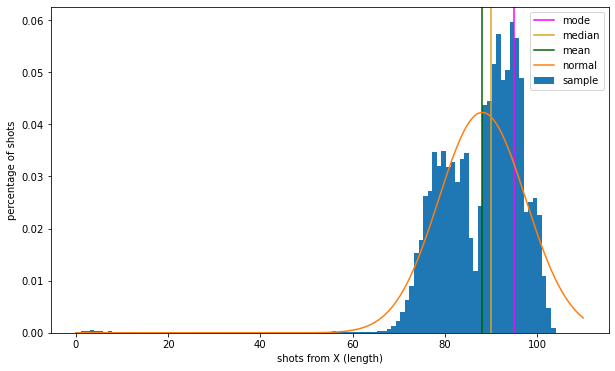

In [26]:
plt.figure(figsize=(10,6))
# plot sample density
plt.hist(df['X'], bins=105, density=True, label="sample")
#Add the mode
plt.axvline(df['X'].mode()[0], color='magenta', label='mode')
#Add the median
plt.axvline(df['X'].median(), color='goldenrod', label='median')
#Add the mean
plt.axvline(df['X'].mean(), color='darkgreen', label='mean')
#plot and label my graph
plt.legend()
plt.xlabel('shots from X (length)')
plt.ylabel('percentage of shots')

# plot normal density
mean = df['X'].mean()
std = df['X'].std()

xvals = np.arange(0, 110, 0.01)
plt.plot(xvals, norm.pdf(xvals, loc=mean, scale=std), label="normal")

plt.legend()
plt.show()

In [27]:
#seeing the statistic values 
df['X'].describe()

count    227614.000000
mean         88.103298
std           9.437362
min           0.000000
25%          82.000000
50%          90.000000
75%          95.000000
max         104.000000
Name: X, dtype: float64

In [29]:
#plotly box plot 
fig = px.box(
    df,
    x='result',
    y="X",
    title="Distance Distribution per result",
    width=800,
    height=500
)

fig.show()

The above graphs descirbe the same thing: 

- the closer the number is to 105, the closer you are to goal. 

They are quite intuitive. More shots are taken from a closer location because there is a higher likelihood to score from those locations. So players opt to shoot from a closer distance. 

In [30]:
fig = px.histogram(
    df, 
    x='Y',
    nbins=90,
    title="Shots from distance (width)",
    width=800,
    height=500
)
fig.show()

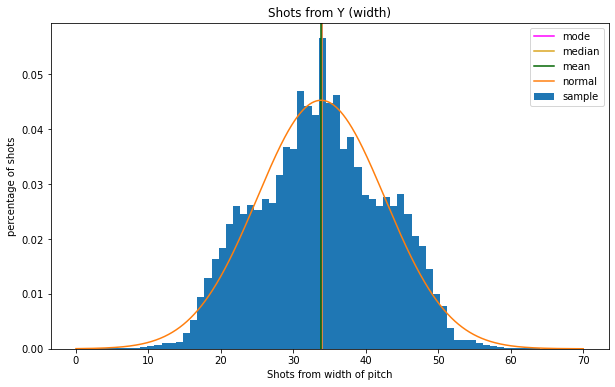

In [29]:
plt.figure(figsize=(10,6))
# plot sample density
plt.hist(df['Y'], bins=68, density=True, label="sample")
#Add the mode
plt.axvline(df['Y'].mode()[0], color='magenta', label='mode')
#Add the median
plt.axvline(df['Y'].median(), color='goldenrod', label='median')
#Add the mean
plt.axvline(df['Y'].mean(), color='darkgreen', label='mean')
#plot and label my graph
plt.legend()
plt.title ('Shots from Y (width)')
plt.xlabel('Shots from width of pitch')
plt.ylabel('percentage of shots')

# plot normal density
mean = df['Y'].mean()
std = df['Y'].std()

xvals = np.arange(0, 70, 0.01)
plt.plot(xvals, norm.pdf(xvals, loc=mean, scale=std), label="normal")

plt.legend()
plt.show()

In [30]:
df['Y'].describe()

count    227614.000000
mean         33.814656
std           8.811231
min           0.000000
25%          28.000000
50%          34.000000
75%          40.000000
max          67.000000
Name: Y, dtype: float64

In [31]:
fig = px.box(
    df,
    x='result',
    y="Y",
    title="Distance(length) per result",
    width=800,
    height=500
)

fig.show()

The above graphs are describing the same thing. 

The above graphs look normally distributed. This makes sense if you think about it; The 34 meter mark, denotes the middle of the width of the pitch. This means that the shot was taken when the goal is directly infront of you. This means you can see most of the goal and have the widest shot angle, translating to a higher probability of shooting it on target and hence scoring.

### Feature Engineering: Distance and Angle columns 

Formerly, we only had the X and Y coordinates on the pitch. These dont give us the exact angle and ditance of the shot, just the location. 

In [32]:
for i,shot in df.iterrows():
    #now we are interested in distance from the goal as well as the angle formed with the goal
    #now we use dummy variables x and y to calc distance and angle attributes
    df.at[i,'X']=100-shot['X']
    df.at[i,'Y']=shot['Y']
    df.at[i,'C']=abs(shot['Y']-50)
    
    #Distance in metres and shot angle in degrees.
    #we are interested in the angle made between the width of the goal and the
    #straight line distance to the shot location. A goal is 7.32 meters wide
    x=df.at[i,'X']*105/100
    y=df.at[i,'C']*65/100
    df.at[i,'Distance']=np.sqrt(x**2 + y**2)
    a = np.arctan(7.32 *x /(x**2 + y**2 - (7.32/2)**2))
    if a<0:
        a=np.pi+a
    df.at[i,'Angle'] = a*180/3.14

In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  object 
 7   player_id        227614 non-null  int64  
 8   situation        227614 non-null  object 
 9   season           227614 non-null  int64  
 10  shotType         227614 non-null  object 
 11  match_id         227614 non-null  int64  
 12  h_team           227614 non-null  object 
 13  a_team           227614 non-null  object 
 14  h_goals          227614 non-null  int64  
 15  a_goals          227614 non-null  int64  
 16  date             227614 non-null  obje

In [34]:
df.head()

,id,minute,result,X,Y,player,h_a,player_id,situation,season,...,h_team,a_team,h_goals,a_goals,date,player_assisted,lastAction,C,Distance,Angle
0,200247,27,0,17,28,Juan Mata,h,554,DirectFreekick,2015,...,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Standard,22.0,22.871653,14.385033
1,200248,27,0,10,42,Memphis Depay,h,555,SetPiece,2015,...,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Ashley Young,Pass,8.0,11.717082,31.830237
2,200249,35,0,12,22,Juan Mata,h,554,OpenPlay,2015,...,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Wayne Rooney,Pass,28.0,22.135944,10.957994
3,200250,35,0,11,36,Juan Mata,h,554,OpenPlay,2015,...,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Tackle,14.0,14.704166,22.640720
4,200251,40,0,15,48,Memphis Depay,h,555,OpenPlay,2015,...,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Michael Carrick,BallRecovery,2.0,15.803560,26.015350


In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  object 
 7   player_id        227614 non-null  int64  
 8   situation        227614 non-null  object 
 9   season           227614 non-null  int64  
 10  shotType         227614 non-null  object 
 11  match_id         227614 non-null  int64  
 12  h_team           227614 non-null  object 
 13  a_team           227614 non-null  object 
 14  h_goals          227614 non-null  int64  
 15  a_goals          227614 non-null  int64  
 16  date             227614 non-null  obje

In [36]:
df['Angle'].describe()

count    227614.000000
mean         24.395670
std          31.499206
min           0.000000
25%          11.519226
50%          15.947785
75%          23.060925
max         179.612923
Name: Angle, dtype: float64

As you can see, the maximum angle is 179 degrees. This makes sense, because if you are  exactly infront of the goal each post is exactly to your left and right (meaning your on the goal line), which means it is a straight line, and the angle of a straight line is 180 degrees. As you get further from the goal the angle decreases. 

We can see that most shots are taken at an angle of 23 degrees. 

However, most shots are not taken from that close to the goal, so as you get farther away from the goal the angle decreases. 

In [37]:
df['Distance'].describe()

count    227614.000000
mean         17.931661
std           8.727484
min           0.000000
25%          11.850105
50%          17.111473
75%          23.245860
max         105.883533
Name: Distance, dtype: float64

The Distance column is the distance from goal with the angle in consideration.

As we can see the mean shooting distance is 19 meters away from goal.

In [38]:
df = df.drop(columns = ['C'])
df.head()

,id,minute,result,X,Y,player,h_a,player_id,situation,season,...,match_id,h_team,a_team,h_goals,a_goals,date,player_assisted,lastAction,Distance,Angle
0,200247,27,0,17,28,Juan Mata,h,554,DirectFreekick,2015,...,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Standard,22.871653,14.385033
1,200248,27,0,10,42,Memphis Depay,h,555,SetPiece,2015,...,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Ashley Young,Pass,11.717082,31.830237
2,200249,35,0,12,22,Juan Mata,h,554,OpenPlay,2015,...,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Wayne Rooney,Pass,22.135944,10.957994
3,200250,35,0,11,36,Juan Mata,h,554,OpenPlay,2015,...,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,NaN,Tackle,14.704166,22.640720
4,200251,40,0,15,48,Memphis Depay,h,555,OpenPlay,2015,...,81,Manchester United,Tottenham,1,0,2015-08-08 15:45:00,Michael Carrick,BallRecovery,15.803560,26.015350


The `C` column, is no longer required as we have computed our angles and Distance column. 

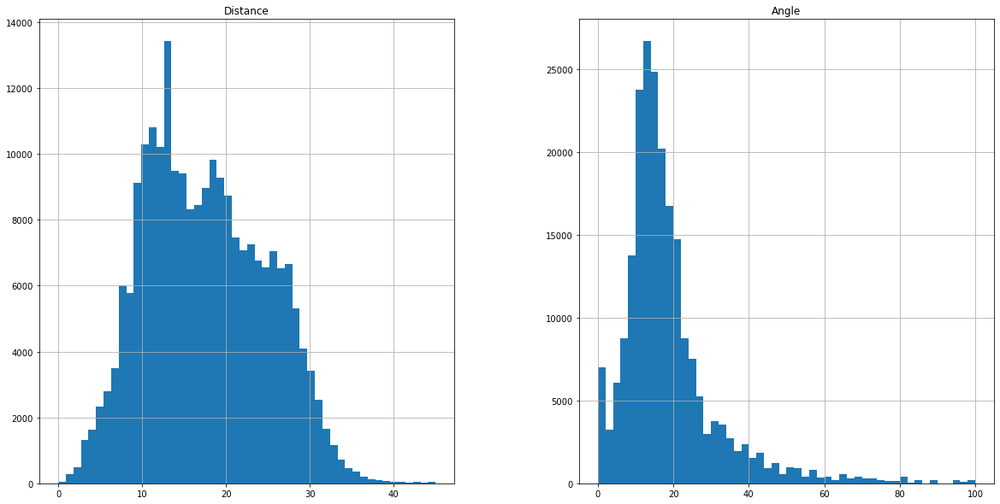

In [39]:
#plot distributions of shots by distance and angle side by side
fig, axes = plt.subplots(1, 2, figsize=(20,10))
distance = df.hist("Distance",bins=50,range = (0,45),ax= axes[0])
angles = df.hist("Angle",bins=50, range = (0,100),ax=axes[1])

The above graphs show us the distributions of the Ditance and angle of the shots. As we can see, the distance graph looks normally distributed. What it is saying is that most shots occur at around 15 meters out. Shots from very close and very far seem to shows similar probabilities. In football terms, this can be translated to shots from close are hard to come across due to the opposing team defending. And for the latter, players dont opt to shoot from to far out because it is highly unlikely that they score. 

As for the Angle graph, It seems that it is highly right skewed. As we can see, most of the shots observations fall below 25 degrees. At first I found this quite surprising, however I did some more research and discovered what 20 degrees and less actually looks like in football. Below, I show screenshots of an interactive angle football calculator I found. The link is pasted below if you would like to take a look.  

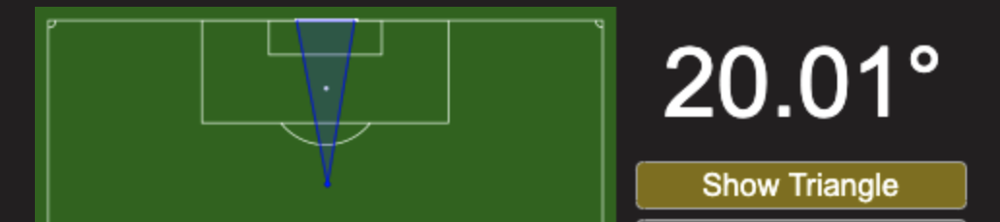

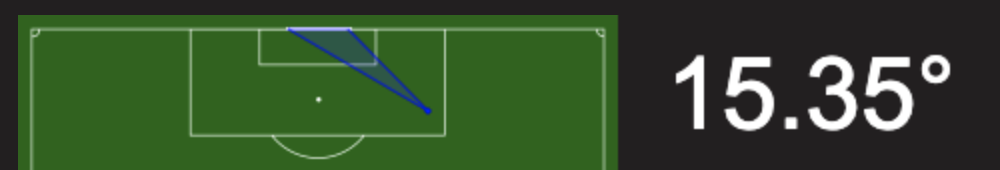

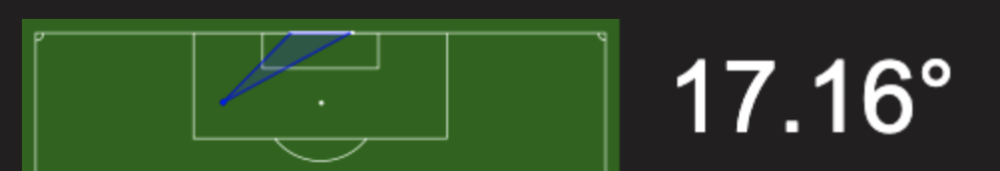

Interactive visual for angles: https://datagenetics.com/blog/march12019/index.html#

All of the shots shown above are realtively good shots and are around a 20 degree angle. From watching alot of football matches I know that these are common shooting areas and are considered dangerous areas to shoot from especially if you are shooting with your preferred foot. 

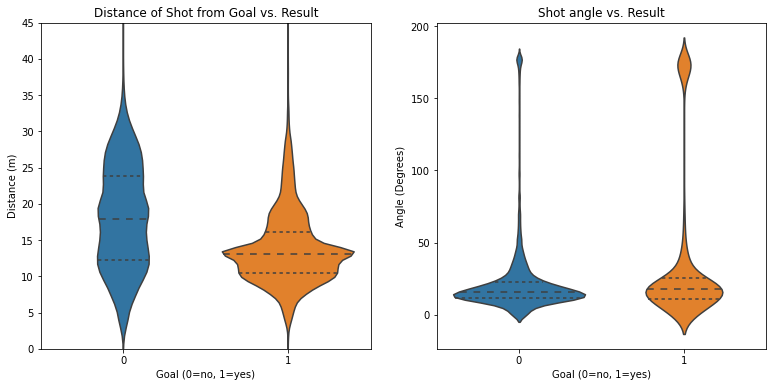

In [40]:
#use the seaborn library to inspect the distribution of the shots by result (goal or no goal) 
fig, axes = plt.subplots(1, 2,figsize=(13, 6))

#use seaborn lib for violin plot and extract necessary columns from our dataframe df
shot_dist = sns.violinplot(x="result", y="Distance",
                    data=df, inner="quart",ax= axes[0])
shot_dist.set(xlabel="Goal (0=no, 1=yes)",
       ylabel="Distance (m)",
       title="Distance of Shot from Goal vs. Result",ylim=(0, 45));

#similar as before
shot_ang = sns.violinplot(x="result", y="Angle",
                    data=df, inner="quart",ax = axes[1])
shot_ang.set(xlabel="Goal (0=no, 1=yes)",
       ylabel="Angle (Degrees)",
       title="Shot angle vs. Result");

The violin plot above plays a similar role to a box and whiskers plot but also provides a smoothing of the distribution. In splitting up the data by the result of the shot, we can see that on average, shots that result in goals are taken closer to goal than shots that do not result in goals. We can say the same for the angles. The violin plot shows that goals are scored from a slightly wider angle. 

In [41]:
df_goals = df[df['result']==1]
df_no_goal = df[df['result']==0]

In [42]:
goal_angle_mean = df_goals['Angle'].mean()
non_goal_angle_mean = df_no_goal['Angle'].mean()
goal_distance_mean = df_goals['Distance'].mean()
non_goal_distance_mean = df_no_goal['Distance'].mean()

In [43]:
#average angle of goals
print(f'The average shooting angle that results in a goal is: {goal_angle_mean} degrees')
#average angle of  non-goals
print(f'The average shooting angle that does not result in a goal is:{non_goal_angle_mean} degrees')
#average distance of goals
print(f'The average shooting distance that results in a goal is: {goal_distance_mean} meters')
#average distance of  non-goals
print(f'The average shooting sitance that does not result in a goal is: {non_goal_distance_mean} meters')

The average shooting angle that results in a goal is: 35.01999940829593 degrees
The average shooting angle that does not result in a goal is:23.1380690622341 degrees
The average shooting distance that results in a goal is: 13.783744290791647 meters
The average shooting sitance that does not result in a goal is: 18.422649623572838 meters


The above summary shows the averages. These are inline with our violin plots above!

### Binarizing the `h_a` column:

In [44]:
#absolute number of value counts of the h_a 'column'
df["h_a"].value_counts()

h    125464
a    102150
Name: h_a, dtype: int64

In [45]:
#relative number of value counts of the h_a 'column'
df["h_a"].value_counts(normalize=True)

h    0.551214
a    0.448786
Name: h_a, dtype: float64

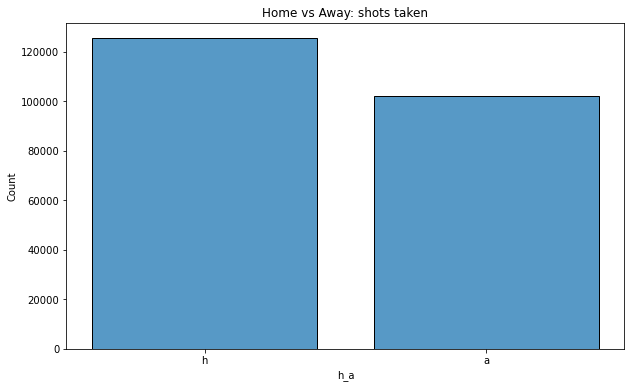

In [46]:
plt.figure(figsize=(10,6))
sns.histplot(df['h_a'], discrete=True, shrink=0.8)
plt.title("Home vs Away: shots taken")
plt.show()

As we can see from the above it seems more shots are taken when teams are playing at home than away, this is an interesting result, as it is common knowledge in the sports world that teams usually prefer to play in their home stadium infront of their supporters, and the above confirms this. 

In [47]:
#binarizing the home and away values. 
df["h_a"] = np.where(df["h_a"] == "h", 1, 0)

In [48]:
#sanity check. 
df["h_a"].unique()

array([1, 0])

### Dealing with the null values from `player_assisted` column :

In [49]:
# checking for null values.
df.isnull().sum()

id                     0
minute                 0
result                 0
X                      0
Y                      0
player                 0
h_a                    0
player_id              0
situation              0
season                 0
shotType               0
match_id               0
h_team                 0
a_team                 0
h_goals                0
a_goals                0
date                   0
player_assisted    60453
lastAction             0
Distance               0
Angle                  0
dtype: int64

In [50]:
#some events are not assisted, hence it is not applicable 
df = df.fillna('notApplicable')

The `player_assisted` column basically outputs who the player that assisted that shot is. However in many instances in football a shot may not be assisted, it may be due to the creativity and skill of an individual player or a mistake from a defender. So for the aforementioned reason I am filling the nulls with 'notApplicable'.

In [51]:
#sanity check 
df.isnull().sum()

id                 0
minute             0
result             0
X                  0
Y                  0
player             0
h_a                0
player_id          0
situation          0
season             0
shotType           0
match_id           0
h_team             0
a_team             0
h_goals            0
a_goals            0
date               0
player_assisted    0
lastAction         0
Distance           0
Angle              0
dtype: int64

### Changing the data type of the `date` column:


In [52]:
#Change date to datetime format
df['date'] = pd.to_datetime(df['date']) 

In [53]:
#Sanity check to see if the date datatype was correctly changed 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 21 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   id               227614 non-null  int64         
 1   minute           227614 non-null  int64         
 2   result           227614 non-null  int64         
 3   X                227614 non-null  int64         
 4   Y                227614 non-null  int64         
 5   player           227614 non-null  object        
 6   h_a              227614 non-null  int64         
 7   player_id        227614 non-null  int64         
 8   situation        227614 non-null  object        
 9   season           227614 non-null  int64         
 10  shotType         227614 non-null  object        
 11  match_id         227614 non-null  int64         
 12  h_team           227614 non-null  object        
 13  a_team           227614 non-null  object        
 14  h_goals          227

In [54]:
#Chnaging the date column to four other seperated columns
#here, we are creating a column for year
df['year'] = pd.to_datetime(df['date']).dt.year
# here, we are creating a column for month 
df['month'] = pd.to_datetime(df['date']).dt.month
#here, we are creating a column for day
df['day'] = pd.to_datetime(df['date']).dt.day

In [55]:
#sanity check to make sure the columns were added correctly 
df.head()

,id,minute,result,X,Y,player,h_a,player_id,situation,season,...,h_goals,a_goals,date,player_assisted,lastAction,Distance,Angle,year,month,day
0,200247,27,0,17,28,Juan Mata,1,554,DirectFreekick,2015,...,1,0,2015-08-08 15:45:00,notApplicable,Standard,22.871653,14.385033,2015,8,8
1,200248,27,0,10,42,Memphis Depay,1,555,SetPiece,2015,...,1,0,2015-08-08 15:45:00,Ashley Young,Pass,11.717082,31.830237,2015,8,8
2,200249,35,0,12,22,Juan Mata,1,554,OpenPlay,2015,...,1,0,2015-08-08 15:45:00,Wayne Rooney,Pass,22.135944,10.957994,2015,8,8
3,200250,35,0,11,36,Juan Mata,1,554,OpenPlay,2015,...,1,0,2015-08-08 15:45:00,notApplicable,Tackle,14.704166,22.640720,2015,8,8
4,200251,40,0,15,48,Memphis Depay,1,555,OpenPlay,2015,...,1,0,2015-08-08 15:45:00,Michael Carrick,BallRecovery,15.803560,26.015350,2015,8,8


In [56]:
#sanity check 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 24 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   id               227614 non-null  int64         
 1   minute           227614 non-null  int64         
 2   result           227614 non-null  int64         
 3   X                227614 non-null  int64         
 4   Y                227614 non-null  int64         
 5   player           227614 non-null  object        
 6   h_a              227614 non-null  int64         
 7   player_id        227614 non-null  int64         
 8   situation        227614 non-null  object        
 9   season           227614 non-null  int64         
 10  shotType         227614 non-null  object        
 11  match_id         227614 non-null  int64         
 12  h_team           227614 non-null  object        
 13  a_team           227614 non-null  object        
 14  h_goals          227

In [57]:
#checking new shaoe 
df.shape

(227614, 24)

The updated dataset has 24 columns and the same amount of rows. Since we added the `date` columns into three other columns `year`, `month`, and `day`, we need to remove the `date` column because otherwise we will be repeating the same information. 

In [58]:
#drop the date column since the same information is repeated if we keep it. 
df = df.drop('date', axis=1)

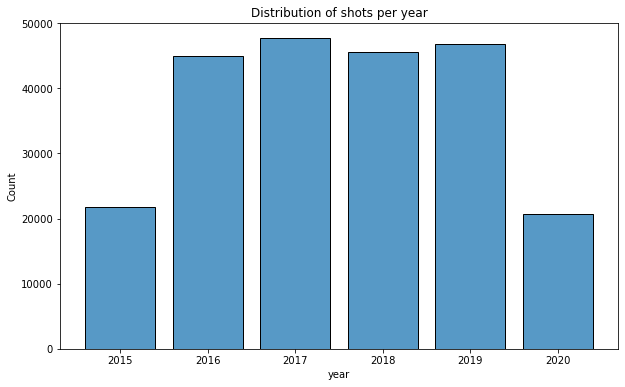

In [59]:
plt.figure(figsize=(10,6))
sns.histplot(df['year'], discrete=True, shrink=0.8)
plt.title('Distribution of shots per year')
plt.show()

We can see here that not much shots were taken in the years 2015 and 2020, but everything in between seems to have many shots. I dont believe there is a specific trend that is hidden here, however some reasons may include: 

- the footballing world was defensive minded in the years of 2015 and 2020
- the footballig world was attacking minded in the years 2016-2019.
- I might have came to the conclusion that in 2020 the low amount of shots was the result of the pandemic, however we see similar findings in the 2015 year.

Overall I am not satisifed with the results of this graph. Let us dig deeper and see how `years` column compares to the `seasons` column:

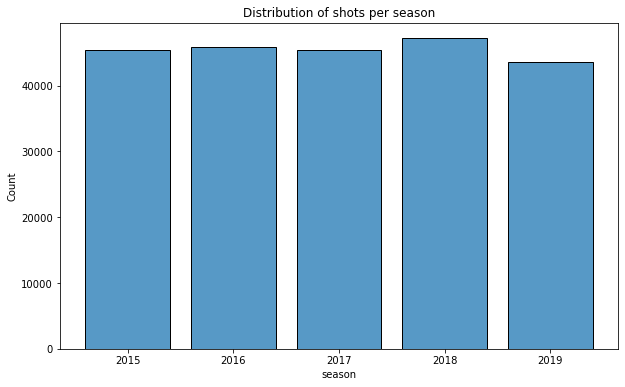

In [60]:
plt.figure(figsize=(10,6))
sns.histplot(df['season'], discrete=True, shrink=0.8)
plt.title('Distribution of shots per season')
plt.show()

This is a much more representative figure of shots taken over a period of time. As we can see here all of the seasons have a similar amount of shots. A season is different from year in that the season usually starts in august and ends in may. What was happening in the `year` plot is that it was accumulating different seasons into a year. I will drop year in order to preserve the shot distribution per year and avoid multicollinearity. 

In [61]:
df = df.drop(columns = ['year'])

In [62]:
#sanity check
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   situation        227614 non-null  object 
 9   season           227614 non-null  int64  
 10  shotType         227614 non-null  object 
 11  match_id         227614 non-null  int64  
 12  h_team           227614 non-null  object 
 13  a_team           227614 non-null  object 
 14  h_goals          227614 non-null  int64  
 15  a_goals          227614 non-null  int64  
 16  player_assisted  227614 non-null  obje

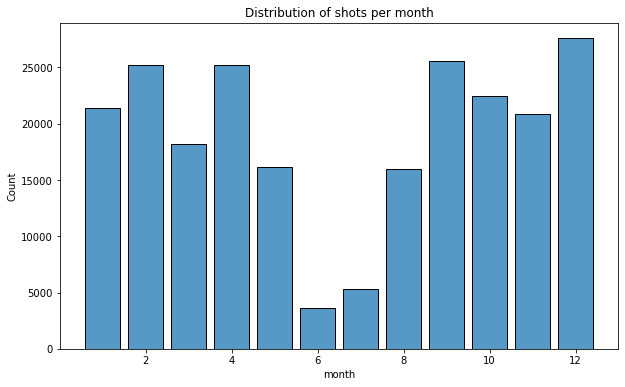

In [63]:
plt.figure(figsize=(10,6))
sns.histplot(df['month'], discrete=True, shrink=0.8)
plt.title('Distribution of shots per month')
plt.show()

The reason behind this bimodal looking shape is that we consider 5 different leagues all which start and end at slighlty different times. In the months of:
- January (1)
- Febreuary (2)
- March (3) 
- April (4) 
- September (9) 
- October (10) 
- November (11) 
- December( 12)

the top five leagues are in play, so there is shots data from all of these leagues. That is why there is not much goals in June and July, these are usually the summer months and leagues are at a pause.

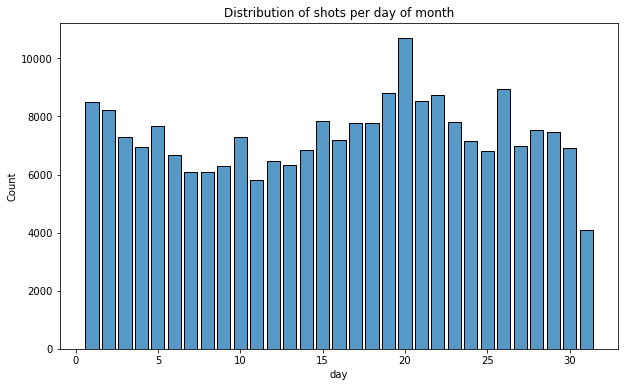

In [64]:
plt.figure(figsize=(10,6))
sns.histplot(df['day'], discrete=True, shrink=0.8)
plt.title('Distribution of shots per day of month')
plt.show()

I dont see or believe there is anything interesting in this graph. Obviously we see a dropoff in shots on the 31st of the month, but this is because not all months go for 31 days. It is interesting that a slightly higer amount of shots is taken on the 20th of every month.

In [65]:
#numeric columns 
numeric_col_list = list(df.select_dtypes("number").columns)
print(numeric_col_list)

['id', 'minute', 'result', 'X', 'Y', 'h_a', 'player_id', 'season', 'match_id', 'h_goals', 'a_goals', 'Distance', 'Angle', 'month', 'day']


In [66]:
#non-numeric columns 
categorical_col_list = list(df.select_dtypes("object").columns)
print(categorical_col_list)

['player', 'situation', 'shotType', 'h_team', 'a_team', 'player_assisted', 'lastAction']


### Binarizing the `player_assisted` column: 

We can also change the `player_assisted` to a binary column. This will assess if the shot was created by an assist or individually. a

In [67]:
df['player_assisted'].value_counts()

notApplicable          60453
Dimitri Payet            517
Kevin De Bruyne          458
Alejandro Gomez          450
Christian Eriksen        436
                       ...  
Borja Lasso                1
Emerson Hyndman            1
Francisco Rodríguez        1
Asmir Begovic              1
Eugenio Lamanna            1
Name: player_assisted, Length: 4331, dtype: int64

In [68]:
df['player_assisted'].value_counts(normalize=True)

notApplicable          0.265594
Dimitri Payet          0.002271
Kevin De Bruyne        0.002012
Alejandro Gomez        0.001977
Christian Eriksen      0.001916
                         ...   
Borja Lasso            0.000004
Emerson Hyndman        0.000004
Francisco Rodríguez    0.000004
Asmir Begovic          0.000004
Eugenio Lamanna        0.000004
Name: player_assisted, Length: 4331, dtype: float64

As we can see we have 4331 player assists for shots (not goals). 

In [69]:
#binarizing 'player_assisted' column. 0 mena no assist, 1 means its was assisted
df['player_assisted'] = np.where(df['player_assisted'] == 'notApplicable', 0, 1)

In [70]:
#sanity check
df['player_assisted'].unique()

array([0, 1])

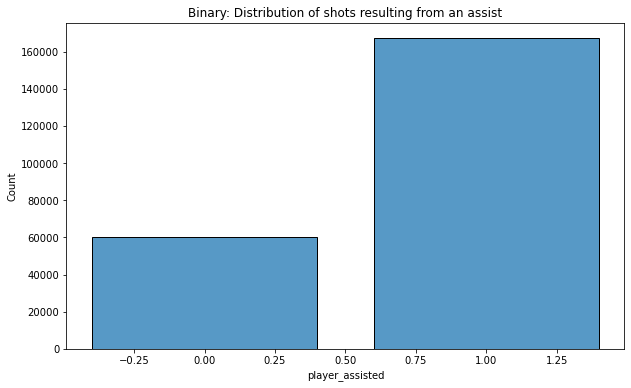

In [71]:
plt.figure(figsize=(10,6))
sns.histplot(df['player_assisted'], discrete=True, shrink=0.8)
plt.title('Binary: Distribution of shots resulting from an assist')
plt.show()

There is a large imbalance in terms of if the shot was assisted. This is to be expected as football is a team sport, and working with teammates is a large part of whether chances (shots) are or can be created. 

### Binarizing the `shotType` column: 


In [72]:
#checking each class
df["shotType"].value_counts()

RightFoot        116481
LeftFoot          72006
Head              38236
OtherBodyPart       891
Name: shotType, dtype: int64

In [73]:
#Checking percentage of each class 
df["shotType"].value_counts(normalize=True)

RightFoot        0.511748
LeftFoot         0.316351
Head             0.167986
OtherBodyPart    0.003915
Name: shotType, dtype: float64

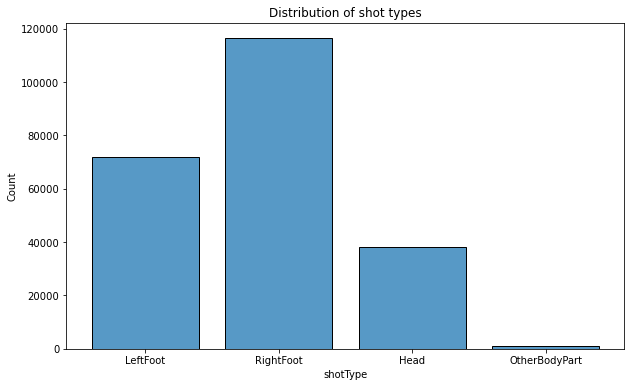

In [74]:
plt.figure(figsize=(10,6))
sns.histplot(df['shotType'], discrete=True, shrink=0.8)
plt.title('Distribution of shot types')
plt.show()

The graph above makes sense. The majority of people in the world are right-handed/right-footed so we observe the most shots taken with the right foot. After this comes the left foot. It doesn't come as a surprise that most shots occur from a shot with the foot, as it is football.

To make the model clearer, we will binarize the `shotType` column to either a shot with the any foot or a header. Since the 'OtherBodyPart' result is miniscule at only 0.3% we will include it with the headers. 

In [75]:
#any value in the shotType column will be binarized 
np.where(df['shotType'].str.contains('Foot'), 1, 0)

array([1, 1, 1, ..., 0, 0, 1])

In [76]:
#renaming the column 
df['ShotType'] = np.where(df['shotType'].str.contains('Foot'), 1, 0)

In [77]:
#sanity check
df['ShotType'].unique()

array([1, 0])

In [78]:
#sanity check, the number matchup with the above 
df['ShotType'].value_counts()

1    188487
0     39127
Name: ShotType, dtype: int64

Now we have a column that shows if the shot was with the foot, which is a more conventional way of taking a shot hence there being a larger amount of shots with feet, versus a header. 
- 1 = shot with the foot 
- 0 = shot with header or other body part. 

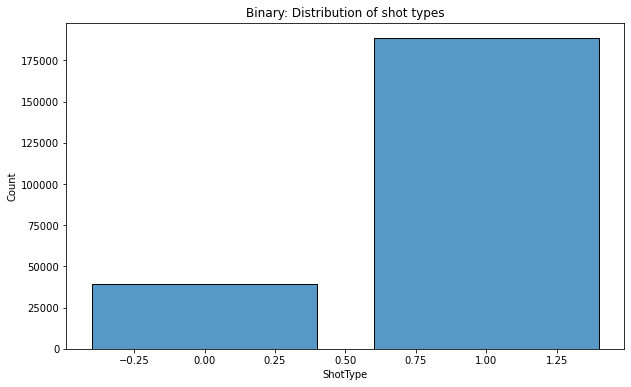

In [79]:
plt.figure(figsize=(10,6))
sns.histplot(df['ShotType'], discrete=True, shrink=0.8)
plt.title('Binary: Distribution of shot types')
plt.show()

There is a large class imbalance after we binarized. But this is representative of our observations. 

In [80]:
#dropping the shottype column to avoid column replication 
df = df.drop('shotType', axis=1)

In [81]:
#sanity check 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   situation        227614 non-null  object 
 9   season           227614 non-null  int64  
 10  match_id         227614 non-null  int64  
 11  h_team           227614 non-null  object 
 12  a_team           227614 non-null  object 
 13  h_goals          227614 non-null  int64  
 14  a_goals          227614 non-null  int64  
 15  player_assisted  227614 non-null  int64  
 16  lastAction       227614 non-null  obje

In [82]:
#numeric columns 
numeric_col_list = list(df.select_dtypes("number").columns)
print(numeric_col_list)

['id', 'minute', 'result', 'X', 'Y', 'h_a', 'player_id', 'season', 'match_id', 'h_goals', 'a_goals', 'player_assisted', 'Distance', 'Angle', 'month', 'day', 'ShotType']


In [83]:
#non-numeric columns 
categorical_col_list = list(df.select_dtypes("object").columns)
print(categorical_col_list)

['player', 'situation', 'h_team', 'a_team', 'lastAction']


### Binarizing `situation` column: 

In [84]:
# checking each class 
df["situation"].value_counts()

OpenPlay          166096
FromCorner         33506
SetPiece           14908
DirectFreekick     10321
Penalty             2783
Name: situation, dtype: int64

In [85]:
# checking percentage of each class 
df["situation"].value_counts(normalize=True)

OpenPlay          0.729727
FromCorner        0.147205
SetPiece          0.065497
DirectFreekick    0.045344
Penalty           0.012227
Name: situation, dtype: float64

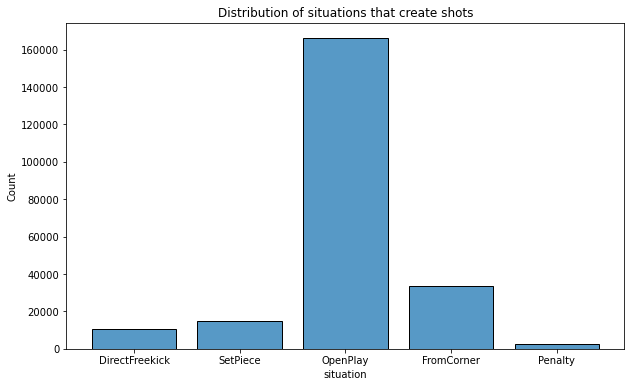

In [86]:
plt.figure(figsize=(10,6))
sns.histplot(df['situation'], discrete=True, shrink=0.8)
plt.title('Distribution of situations that create shots')
plt.show()

A set piece occurs any time there is a restart of play from a foul or the ball going out of play. Technically, corners, freekicks, and penalties are all set peices. 


So we will group openplay as 1 and the rest as 0.

In [87]:
#binarizing this column
np.where(df['situation'].str.contains('OpenPlay'), 1, 0)

array([0, 0, 1, ..., 1, 1, 1])

In [88]:
# renaming this new column 
df['Situation'] = np.where(df['situation'].str.contains('OpenPlay'), 1, 0)

In [89]:
#sanity check 
df['Situation'].unique()

array([0, 1])

In [90]:
#sanity check, the number add up 
df['Situation'].value_counts()

1    166096
0     61518
Name: Situation, dtype: int64

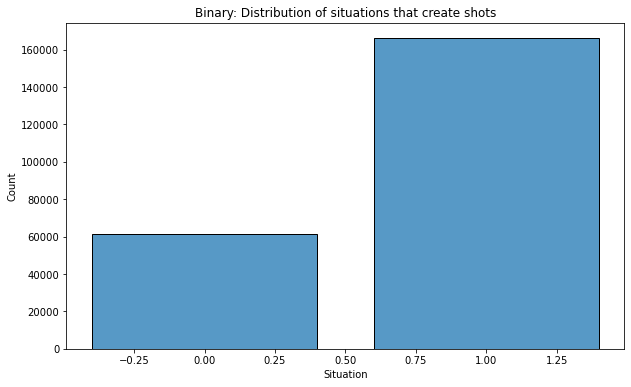

In [91]:
plt.figure(figsize=(10,6))
sns.histplot(df['Situation'], discrete=True, shrink=0.8)
plt.title('Binary: Distribution of situations that create shots')
plt.show()

This is representative of football in general. Many goals due occur from set pieces, however a larger amount of goals occur from openplay. 

In [92]:
#dropping the column to avoid column replication 
df = df.drop('situation', axis=1)

In [93]:
#sanity check 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   season           227614 non-null  int64  
 9   match_id         227614 non-null  int64  
 10  h_team           227614 non-null  object 
 11  a_team           227614 non-null  object 
 12  h_goals          227614 non-null  int64  
 13  a_goals          227614 non-null  int64  
 14  player_assisted  227614 non-null  int64  
 15  lastAction       227614 non-null  object 
 16  Distance         227614 non-null  floa

In [94]:
#numeric columns 
numeric_col_list = list(df.select_dtypes("number").columns)
print(numeric_col_list)

['id', 'minute', 'result', 'X', 'Y', 'h_a', 'player_id', 'season', 'match_id', 'h_goals', 'a_goals', 'player_assisted', 'Distance', 'Angle', 'month', 'day', 'ShotType', 'Situation']


In [95]:
#non-numeric columns 
categorical_col_list = list(df.select_dtypes("object").columns)
print(categorical_col_list)

['player', 'h_team', 'a_team', 'lastAction']


### Binarizing `lastAction` column 

In [96]:
# checking each class 
df["lastAction"].value_counts()

Pass               80796
Cross              31849
None               26253
Aerial             16903
Standard           13104
TakeOn             12155
Chipped            11870
Rebound             9899
HeadPass            5454
BallRecovery        5162
Throughball         4612
BallTouch           3588
LayOff              2158
Dispossessed        1302
Tackle               543
Foul                 353
CornerAwarded        294
Interception         280
BlockedPass          251
End                  171
Goal                 148
Challenge             98
Clearance             84
OffsidePass           52
Card                  52
GoodSkill             45
Save                  44
SubstitutionOn        32
Start                 12
FormationChange       10
KeeperPickup           9
Error                  7
Punch                  6
OffsideProvoked        5
KeeperSweeper          4
ShieldBallOpp          3
PenaltyFaced           2
CrossNotClaimed        1
ChanceMissed           1
Smother                1


In [97]:
# checking percentage of each class 
df["lastAction"].value_counts(normalize=True)

Pass               0.354969
Cross              0.139925
None               0.115340
Aerial             0.074262
Standard           0.057571
TakeOn             0.053402
Chipped            0.052150
Rebound            0.043490
HeadPass           0.023962
BallRecovery       0.022679
Throughball        0.020262
BallTouch          0.015764
LayOff             0.009481
Dispossessed       0.005720
Tackle             0.002386
Foul               0.001551
CornerAwarded      0.001292
Interception       0.001230
BlockedPass        0.001103
End                0.000751
Goal               0.000650
Challenge          0.000431
Clearance          0.000369
OffsidePass        0.000228
Card               0.000228
GoodSkill          0.000198
Save               0.000193
SubstitutionOn     0.000141
Start              0.000053
FormationChange    0.000044
KeeperPickup       0.000040
Error              0.000031
Punch              0.000026
OffsideProvoked    0.000022
KeeperSweeper      0.000018
ShieldBallOpp      0

We can see from the above table that a pass as a last action before a shot is observed 35% of the time and a cross as a last action before a shot is observed around 13% of the time. However, these are essentially the same thing. a Cross is just a pass that is not on the ground. This is why I will opt to binarize this column. I was initially going to onehot encode this, however I believe binarizing is better in this case due to my above reasoning.

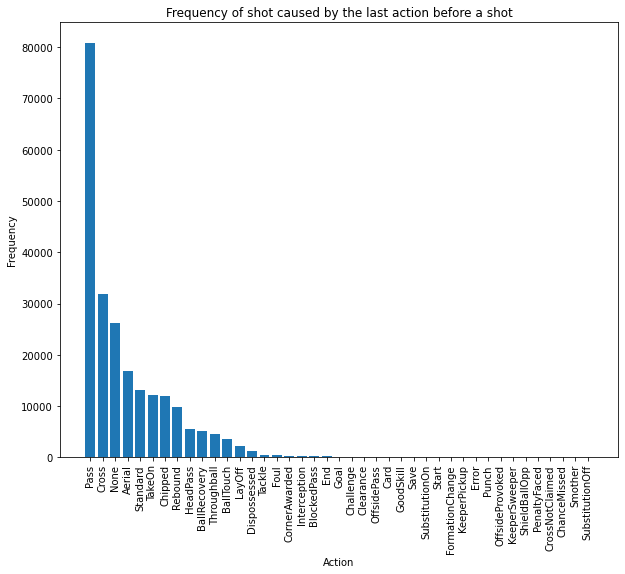

In [98]:
plt.figure(figsize=(10,8))
plt.bar(df['lastAction'].value_counts().index,
        df['lastAction'].value_counts().values)
plt.xticks(rotation=90)
plt.xlabel('Action')
plt.ylabel('Frequency')
plt.title('Frequency of shot caused by the last action before a shot')
plt.show()

In [99]:
np.where(df['lastAction'].str.contains('Pass', 'Cross'), 1, 0)

array([0, 1, 1, ..., 0, 0, 0])

In [100]:
# renaming this new column 
df['lastActionPass'] = np.where(df['lastAction'].str.contains('Pass', 'Cross'), 1, 0)

In [101]:
#checking each class 
df["lastActionPass"].value_counts()

0    141061
1     86553
Name: lastActionPass, dtype: int64

In [102]:
# checking percentage of each class
df["lastActionPass"].value_counts(normalize=True)

0    0.619738
1    0.380262
Name: lastActionPass, dtype: float64

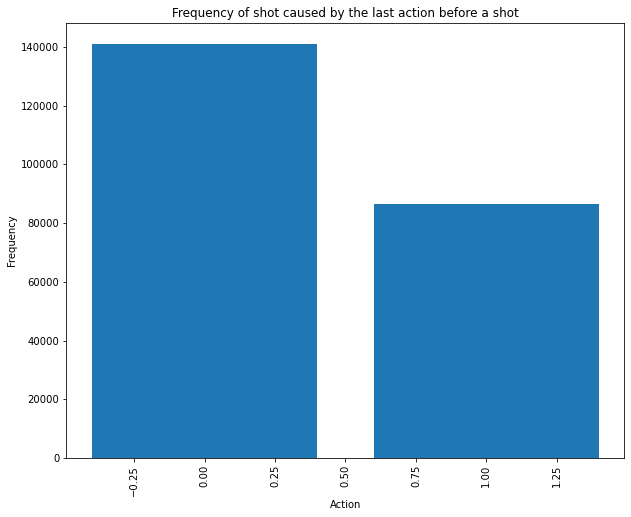

In [103]:
plt.figure(figsize=(10,8))
plt.bar(df['lastActionPass'].value_counts().index,
        df['lastActionPass'].value_counts().values)
plt.xticks(rotation=90)
plt.xlabel('Action')
plt.ylabel('Frequency')
plt.title('Frequency of shot caused by the last action before a shot')
plt.show()

In [104]:
#drop the column to avoid repeating information
df = df.drop('lastAction', axis=1)

In [105]:
#sanity check 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   season           227614 non-null  int64  
 9   match_id         227614 non-null  int64  
 10  h_team           227614 non-null  object 
 11  a_team           227614 non-null  object 
 12  h_goals          227614 non-null  int64  
 13  a_goals          227614 non-null  int64  
 14  player_assisted  227614 non-null  int64  
 15  Distance         227614 non-null  float64
 16  Angle            227614 non-null  floa

In [106]:
#numeric columns 
numeric_col_list = list(df.select_dtypes("number").columns)
print(numeric_col_list)

['id', 'minute', 'result', 'X', 'Y', 'h_a', 'player_id', 'season', 'match_id', 'h_goals', 'a_goals', 'player_assisted', 'Distance', 'Angle', 'month', 'day', 'ShotType', 'Situation', 'lastActionPass']


In [107]:
#non-numeric columns 
categorical_col_list = list(df.select_dtypes("object").columns)
print(categorical_col_list)

['player', 'h_team', 'a_team']


The remaining non-numeric columns are 
 - `player`: This is the name of the player who took the shot.
 - `h_team`: This is the name of the home team who took the shot.
 - `a_team`: This is the name of the away team who took the shot.

In [108]:
#shots per minute of a 90 minute game. 
#values that exceed 90 means there was added time due to injury, game disruptions, time wasting etc. 
df['minute'].value_counts()

46     3447
45     3259
47     3036
48     2763
49     2695
       ... 
100      11
99        7
101       4
102       2
103       1
Name: minute, Length: 104, dtype: int64

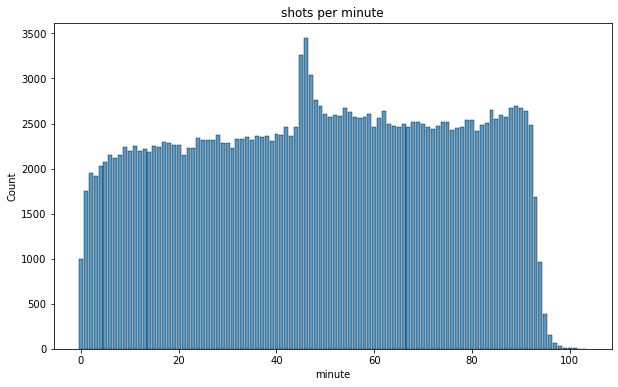

In [109]:
plt.figure(figsize=(10,6))
sns.histplot(df['minute'], discrete=True, shrink=0.8)
plt.title('shots per minute')
plt.show()

- We can see a bit of an increasing trend, however slight it may be. 
- There seems to be an extreme increase in the minutes 45', 46', 47', and 48'.
 - this is interesting because football games are cut in to 2 halfs of 45 minutes. 
- This means most goals seem to be at the end of the first half and the beginning of the second half. 
- A match is technically 90 minutes of football. But we can see that the minutes go up to 103 minutes, even though there arent many observations there. This is becasue alot of events take place that create dead time and cause the referee to increase the time.

In [110]:
df['minute'].describe()

count    227614.000000
mean         48.628740
std          26.578938
min           0.000000
25%          26.000000
50%          49.000000
75%          71.000000
max         103.000000
Name: minute, dtype: float64

In [111]:
#If you are a football fan, you were probably expecting the see the names shown in the output below. 
df['player'].value_counts()

Cristiano Ronaldo       950
Lionel Messi            862
Robert Lewandowski      704
Lorenzo Insigne         695
Edin Dzeko              666
                       ... 
Álex López                1
Fran Manzanara            1
Marvin Emnes              1
Abel Ruiz                 1
Kristoffer Askildsen      1
Name: player, Length: 4339, dtype: int64

It seems cristiano ronaldo had taken the most shots. Second is lionel messi in shots taken. Third is robert lewandowski. 

The above results does not mean they have scored the most goals. let us see who the top scorers in our dataset are. 

### Little Experiment: 

In [112]:
cristiano_ronaldo_goals = (df["result"] == 1) & (df['player'] == 'Cristiano Ronaldo')
df[cristiano_ronaldo_goals].shape

(138, 22)

In [113]:
lionel_messi_goals = (df["result"] == 1) & (df['player'] == 'Lionel Messi')
df[lionel_messi_goals].shape

(158, 22)

In [114]:
robert_lewandowski_goals = (df["result"] == 1) & (df['player'] == 'Robert Lewandowski')
df[robert_lewandowski_goals].shape

(145, 22)

As we can see from the tables above: 


- Cristiano Ronaldo took 950 shots and scored 138, that is a conversion rate of 14.5%. 
- Lionel Messi took 862 shots and scored 158 goals, that is a conversion rate of 18.3%. 
- Robert Lewandowski took 704 shots and scored 145 goals, that is a conversion rate of 20.5%.

This shows us that the most shots does not result in the most goals, and the most goals does not result in the highest conversion rate. 

Keep in mind that this analysis is from 2015-2020, and only for league games.

In [115]:
df['player_id'].value_counts()

2371    950
2097    862
227     704
1393    695
1253    666
       ... 
2577      1
6753      1
6999      1
6975      1
8309      1
Name: player_id, Length: 4376, dtype: int64

The above cell is simply the same as the player value counts, the player_id is just the number value of the player.
- Cristiano Ronaldo = 2371. 
- Lionel Messi = 2097.
- Robert Lewandowski = 227 

and so forth...

We can remove either the `player` or player_id information as both column really just give the same information. 

Now that we have cleaned our dataset we will look at some visuals to analyze our most important columns 

## Data Visualization

### Plotting heat maps:

In [116]:
#creating a fullsize football pitch using Matplotlib 
def createPitch():
    #Create figure
    fig=plt.figure()
    fig.set_size_inches(20, 10)
    ax=fig.add_subplot(1,1,1)

    #Pitch Outline & Centre Line
    plt.plot([0,0],[0,68], color="black")
    plt.plot([0,105],[68,68], color="black")
    plt.plot([105,105],[68,0], color="black")
    plt.plot([105,0],[0,0], color="black")
    plt.plot([52.5,52.5],[0,68], color="black")

    #Left Penalty Area
    plt.plot([13.3,13.3],[50,18],color="black")
    plt.plot([0,13.3],[50,50],color="black")
    plt.plot([13.3,0],[18,18],color="black")

    #Right Penalty Area
    plt.plot([105,91.7],[50,50],color="black")
    plt.plot([91.7,91.7],[50,18],color="black")
    plt.plot([91.7,105],[18,18],color="black")

    #Left 6-yard Box
    plt.plot([0,4.5],[42,42],color="black")
    plt.plot([4.5,4.5],[42,26],color="black")
    plt.plot([4.5,0],[26,26],color="black")

    #Right 6-yard Box
    plt.plot([105,100.5],[42,42],color="black")
    plt.plot([100.5,100.5],[42,26],color="black")
    plt.plot([100.5,105],[26,26],color="black")
    
    #Left goal
    plt.plot([-1,0],[30.85,30.85],color="black")
    plt.plot([-1,-1],[30.85,37.15],color="black")
    plt.plot([-1,0],[37.15,37.15],color="black")

    #Right goal
    plt.plot([105,106],[30.85,30.85],color="black")
    plt.plot([106,106],[30.85,37.15],color="black")
    plt.plot([105,106],[37.15,37.15],color="black")

    #Prepare Circles
    centreCircle = plt.Circle((52.5,34),9.15,color="black",fill=False)
    centreSpot = plt.Circle((52.5,34),0.3,color="black")
    leftPenSpot = plt.Circle((8.5,34),0.4,color="black")
    rightPenSpot = plt.Circle((96.5,34),0.3,color="black")

    #Draw Circles
    ax.add_patch(centreCircle)
    ax.add_patch(centreSpot)
    ax.add_patch(leftPenSpot)
    ax.add_patch(rightPenSpot)

    #Prepare Arcs
    leftArc = Arc((7,34),height=20.3,width=18.3,angle=0,theta1=310,theta2=50,color="black")
    rightArc = Arc((98,34),height=20.3,width=18.3,angle=0,theta1=130,theta2=230,color="black")

    #Draw Arcs
    ax.add_patch(leftArc)
    ax.add_patch(rightArc)
    
    #Tidy Axes
    plt.axis('off')

In [117]:
#Creating a halfsize football pitch  
def createPitch2():

    #Create figure
    fig=plt.figure()
    fig.set_size_inches(10, 8)
    ax=fig.add_subplot(1,1,1)

    #Pitch Outline 
    plt.plot([0,0],[0,52.5], color="black")
    plt.plot([0,68],[52.5,52.5], color="black")
    plt.plot([68,68],[52.5,0], color="black")
    plt.plot([68,0],[0,0], color="black")

    #18yrd box
    plt.plot([50,18],[13.3,13.3],color="black")
    plt.plot([50,50],[0,13.3],color="black")
    plt.plot([18,18],[0,13.3],color="black")

    #6-yard Box
    plt.plot([42,26],[4.5,4.5],color="black")
    plt.plot([42,42],[0,4.5],color="black")
    plt.plot([26,26],[0,4.5],color="black")
    
    #goal
    plt.plot([37.15,30.85],[-1,-1],color="black")
    plt.plot([37.15,37.15],[0,-1],color="black")
    plt.plot([30.85,30.85],[0,-1],color="black")

    #Prepare Circles
    PenSpot = plt.Circle((34,8.5),0.3,color="black")
    centreCircle = plt.Circle((34,52.5),9.15,color="black",fill=False)
    centreSpot = plt.Circle((34,52.5),0.3,color="black")


    #Draw Circles
    ax.add_patch(PenSpot)
    ax.add_patch(centreCircle)
    ax.add_patch(centreSpot)

    #Prepare Arcs
    TopArc = Arc((34,7.5),height=20.3,width=18.3,angle=90,theta1=310,theta2=50,color="black")


    #Draw Arcs
    ax.add_patch(TopArc)

    #Tidy Axes
    plt.axis('off')

/Users/sarifarah/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



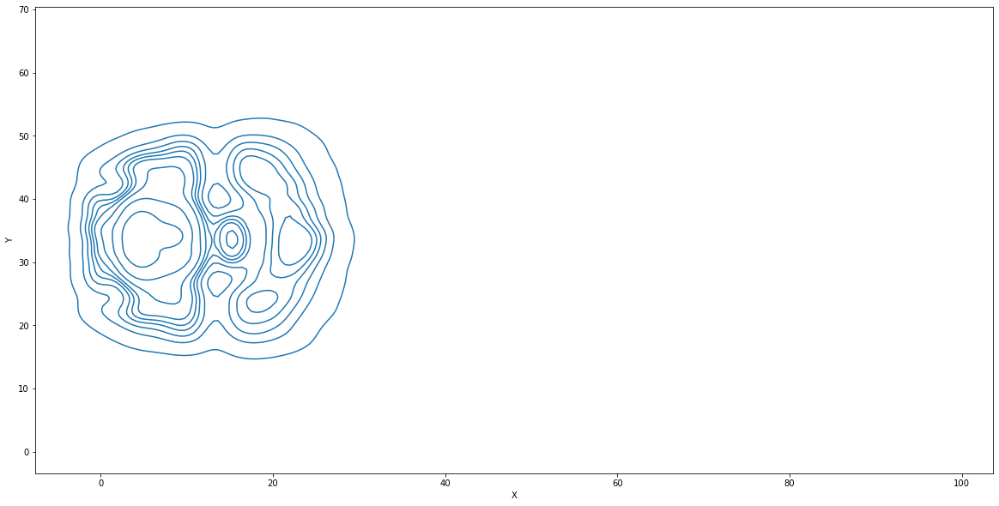

In [118]:
#A kernel density estimate (KDE) plot is a method for visualizing the distribution of observations in a dataset 
#KDE represents the data using a continuous probability density curve in one or more dimensions.
fig, ax = plt.subplots()
fig.set_size_inches(20, 10)
sns.kdeplot(df['X'],df['Y'])
plt.show()

As we can see the from the plot above the most densley populated location on the field are around 0-20 meters away from goal. 

/Users/sarifarah/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



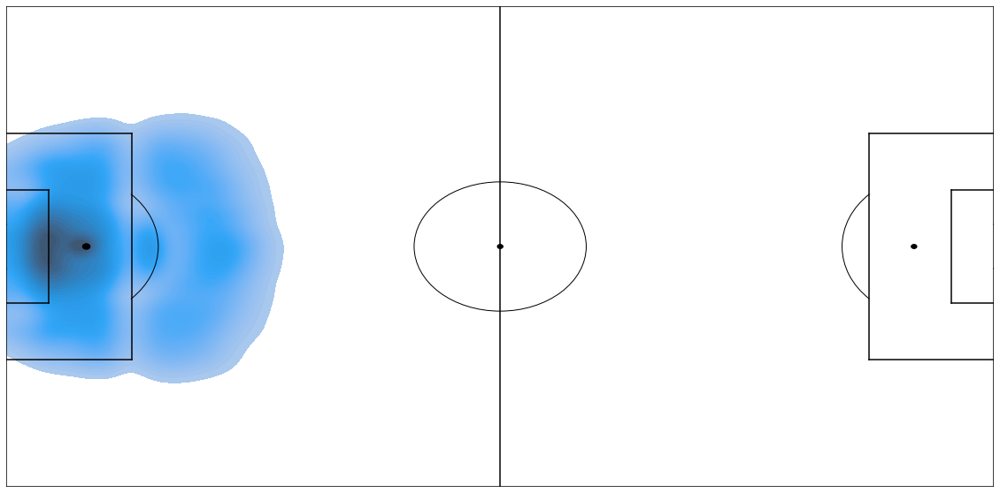

In [119]:
# Shaded kdeplot on the pitch I built above. 
createPitch()

sns.kdeplot(df["X"],df["Y"], shade=True,n_levels=50)
plt.ylim(0, 68)
plt.xlim(0, 105)

plt.show()

This picture shows a better, more refined visual of what we previously saw. This is for all shots. 

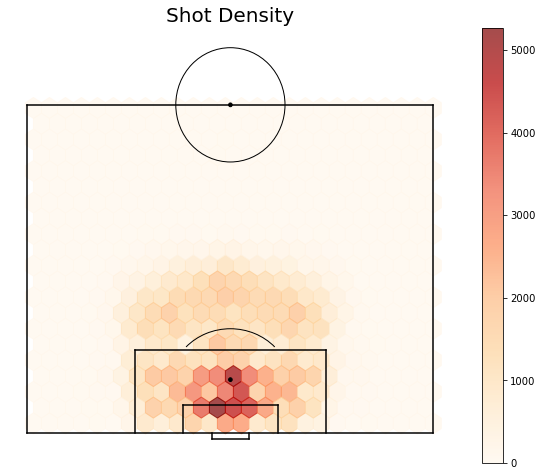

In [120]:
#using a hexbin to plot shots on the second pitch we built above. 
createPitch2()

plt.title("Shot Density", fontsize=20)

df_shots = df[df['id'] >= 0]
plt.hexbin(data = df_shots, x='Y', y='X', zorder=1,cmap='OrRd',gridsize=(25,10),alpha=.7,extent=(1,68,1.5,52))
plt.colorbar()


plt.show()


This visual shows a more detailed picture of what we saw before. This shows the exact location with the highest amount of shots in each bin. 

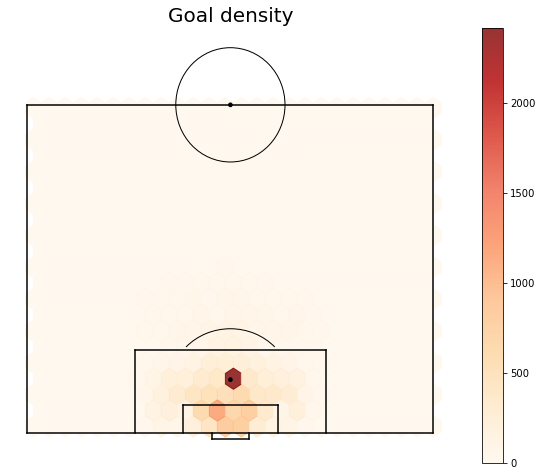

In [121]:
createPitch2()

df_goals = df[df['result']==1]
plt.hexbin(data = df_goals,x='Y', y='X',zorder=1,cmap='OrRd',gridsize=(25,10),alpha=.8,extent=(1,68,1,52))

plt.colorbar()
plt.title('Goal density', fontsize=20)

plt.show()



We have been plotting all of the shots. In the above visual we plot the goal density. This shows us the locations with the most amount of goals. 

These density plots serve a similar function to the violin plots above but give us a much better visual understanding of which areas of the pitch normally produce shots and goals. This is because we can see how both distance and angle impact the distribution of shots on the same plot.

1. As we learned with the violin plots:

2. Shots arent taken from either side the box as much as from the middle due to the poor angle

3. A majority of the shots are taken around the penalty spot (11m)

4. Goals are normally scored within 11 meters and within a very narrow passage

5. It seems that shots are scored heavily from the penalty spot


We must address why there is an extreme decrease in the number of shots on the edge of the box. This could be due to numerous reasons: 

1.Not all football pitches are 105m x 68m. In reality every pitch has its own unique dimensions.

2.This may be due to how the data was recorded. There may be an inclination to record a shot near the penalty box line as either inside the box or outside. Therefore it is possible that shots that happen on the line are being mischaracterized.  

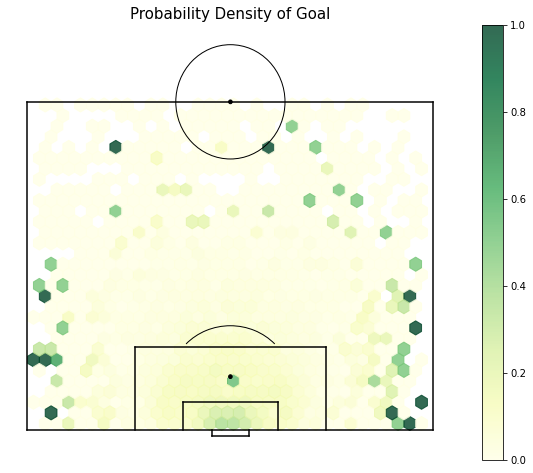

In [122]:
createPitch2()

df_shots = df[df['id'] >= 0]
prob=np.array(df_shots['result']==1)

plt.hexbin(data = df_shots,x='Y', y='X',C=prob,reduce_C_function=np.mean,cmap='YlGn',gridsize=(34,15),
           alpha=.8,extent=(1,68,1,52))
plt.title('Probability Density of Goal', fontsize=15)

plt.colorbar()

plt.show()

This is a probability density visual of shots resulting in a goal. Basically, it is a summary showing the most successful locations to shoot from. As expected, the closer you shoot from the goal, the more likely the shot is to result in a goal. However, it is quite decieving. Notice that there are certain outliers in which the probability density in those bins are very high. This is because there were very few shots taken from those areas, surprisingly these resulted in goals.

In [123]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   season           227614 non-null  int64  
 9   match_id         227614 non-null  int64  
 10  h_team           227614 non-null  object 
 11  a_team           227614 non-null  object 
 12  h_goals          227614 non-null  int64  
 13  a_goals          227614 non-null  int64  
 14  player_assisted  227614 non-null  int64  
 15  Distance         227614 non-null  float64
 16  Angle            227614 non-null  floa

[Text(0.5, 0, 'Avg. Angle of Bin'),
 Text(0, 0.5, 'Probabilty of Goal'),
 Text(0.5, 1.0, 'Probability of Scoring Based on Angle')]

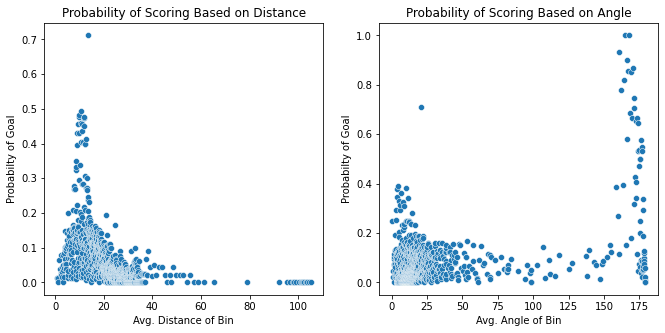

In [124]:
fig, axes = plt.subplots(1, 2,figsize=(11, 5))
df['Distance_Bins'] = pd.qcut(df['Distance'],q=5000, duplicates='drop')
dist_prob = df.groupby('Distance_Bins',as_index=False)['result'].mean()['result']
dist_mean = df.groupby('Distance_Bins',as_index=False)['Distance'].mean()['Distance']
dist_trend = sns.scatterplot(x=dist_mean,y=dist_prob,ax=axes[0])
dist_trend.set(xlabel="Avg. Distance of Bin",
       ylabel="Probabilty of Goal",
       title="Probability of Scoring Based on Distance")

df['Angle_Bins'] = pd.qcut(df['Angle'],q=5000, duplicates='drop')
angle_prob = df.groupby('Angle_Bins',as_index=False)['result'].mean()['result']
angle_mean = df.groupby('Angle_Bins',as_index=False)['Angle'].mean()['Angle']
angle_trend = sns.scatterplot(x=angle_mean,y=angle_prob,ax=axes[1])
angle_trend.set(xlabel="Avg. Angle of Bin",
       ylabel="Probabilty of Goal",
       title="Probability of Scoring Based on Angle")



**Probability of Scoring Based on Distance:** This scatterplot makes sense as we see there is a lower probability of scoring from far out (60-100) meters out. However, what doesnt make sense is that at 0 meters there is a lower probability of scoring than at around 10 meters out, this can be attributed to the fact that if you are very close to the goal you are probably heavily defended and under pressure so you dont score, or that a defender has blocked your shot. Overall we can see that there is a downward trend. In lehmans terms, the further out you are the lower the probability of scoring. 

**Probability of Scoring Based on Angle:** Similarly, this scatterplot is what we expected to see. It is showing that smaller angles result in a lower probability of scoring. There are also some odd things occuring such as shots at a zero degree angle seem to have a similar probability of going in than a shot from a 25-27 degree angle. But , overall we see that there is an upward trend, as the probability of scoring when you are shooting at a 175 degree angle your probability of scoring is very high. In plain english, this means as the angle increases the likelihood of scoring increases. 

**link:** We know that there is a correlation between distance and angle, the further out the shot is the smaller the angle. This correlation is confirmed here aswell. 

We must remember that football is not a strict science, and a player on any given day could miss from very close distances and score from very tight angles. 

Dropping thesecolumns I have created for the above subplots.

In [125]:
df = df.drop(columns = ['Distance_Bins'])

In [126]:
df = df.drop(columns = ['Angle_Bins'])

We no longer need those columns. 

In [127]:
#sanity check
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   season           227614 non-null  int64  
 9   match_id         227614 non-null  int64  
 10  h_team           227614 non-null  object 
 11  a_team           227614 non-null  object 
 12  h_goals          227614 non-null  int64  
 13  a_goals          227614 non-null  int64  
 14  player_assisted  227614 non-null  int64  
 15  Distance         227614 non-null  float64
 16  Angle            227614 non-null  floa

In [128]:
#saving this data in order to use it in the modelling phase 
df.to_csv('df_modelling_final.csv', index=False)

In [129]:
#sanity check
df = pd.read_csv('df_modelling_final.csv')

In [130]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 227614 entries, 0 to 227613
Data columns (total 22 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   id               227614 non-null  int64  
 1   minute           227614 non-null  int64  
 2   result           227614 non-null  int64  
 3   X                227614 non-null  int64  
 4   Y                227614 non-null  int64  
 5   player           227614 non-null  object 
 6   h_a              227614 non-null  int64  
 7   player_id        227614 non-null  int64  
 8   season           227614 non-null  int64  
 9   match_id         227614 non-null  int64  
 10  h_team           227614 non-null  object 
 11  a_team           227614 non-null  object 
 12  h_goals          227614 non-null  int64  
 13  a_goals          227614 non-null  int64  
 14  player_assisted  227614 non-null  int64  
 15  Distance         227614 non-null  float64
 16  Angle            227614 non-null  floa

## Conclusion

In this notebook, we checked the distribution of the shot location using our shour location coorindates, inspected the summary statistics of our features, and also looked at the most common shot locations in our dataset. On top of this, we also engineered two features, the distance and angle of shots taken. We saved the dataset with our engineered feature added to it.

In the next notebook, 3. Modeling, we will try to find the best classification model for our question at hand.  